In [96]:
import os
import re
import numpy as np
import pandas as pd
from datetime import datetime
from dateutil.relativedelta import relativedelta

from src.dlm_functions import computeAnormaly,forwardFilteringM, Model,PlotEWS

import matplotlib.pyplot as plt

fill_value = -9999


In [113]:
# functions
def get_site_info(file = "FLX_ES-Agu_FLUXNET2015_FULLSET_DD_2006-2020_beta-3.csv"):
    pattern = r'(?<=FLX_)([A-Za-z0-9\-]+)(?=_FLUXNET\d+_FULLSET_DD_(\d+)-(\d+))'
    # 使用正则表达式匹配
    match = re.search(pattern, file)

    if match:
        location = match.group(1)  # 地点
        start_year = match.group(2)  # 开始时间
        end_year = match.group(3)  # 结束时间
        
        print("地点:", location)
        print("开始时间:", start_year)
        print("结束时间:", end_year)
        return [location,start_year,end_year]
    else:
        print("没有找到匹配的内容")
        return []
    
# get_site_info('FLX_CH-Oe2_FLUXNET2015_FULLSET_DD_2004-2020_beta-3.csv')

In [98]:
Output_path = './Outputs/gpp_atuoregression/'
Path = './Inputs/Fluxnet2015/'
files = os.listdir(Path)

./Inputs/Fluxnet2015/FLX_ES-Agu_FLUXNET2015_FULLSET_DD_2006-2020_beta-3.csv
地点: ES-Agu
开始时间: 2006
结束时间: 2020
./Inputs/Fluxnet2015/FLX_DE-Kli_FLUXNET2015_FULLSET_DD_2004-2020_beta-3.csv
地点: DE-Kli
开始时间: 2004
结束时间: 2020
./Inputs/Fluxnet2015/FLX_IT-Tor_FLUXNET2015_FULLSET_DD_2008-2020_beta-3.csv
地点: IT-Tor
开始时间: 2008
结束时间: 2020
./Inputs/Fluxnet2015/FLX_GF-Guy_FLUXNET2015_FULLSET_DD_2004-2014_2-4.csv
地点: GF-Guy
开始时间: 2004
结束时间: 2014
./Inputs/Fluxnet2015/FLX_SE-Lnn_FLUXNET2015_FULLSET_DD_2014-2018_beta-3.csv
地点: SE-Lnn
开始时间: 2014
结束时间: 2018
./Inputs/Fluxnet2015/FLX_IT-Ren_FLUXNET2015_FULLSET_DD_1999-2020_beta-3.csv
地点: IT-Ren
开始时间: 1999
结束时间: 2020
./Inputs/Fluxnet2015/FLX_CH-Fru_FLUXNET2015_FULLSET_DD_2005-2020_beta-3.csv
地点: CH-Fru
开始时间: 2005
结束时间: 2020
./Inputs/Fluxnet2015/FLX_CZ-wet_FLUXNET2015_FULLSET_DD_2006-2020_beta-3.csv
地点: CZ-wet
开始时间: 2006
结束时间: 2020
./Inputs/Fluxnet2015/FLX_CH-Aws_FLUXNET2015_FULLSET_DD_2006-2020_beta-3.csv
地点: CH-Aws
开始时间: 2006
结束时间: 2020
./Inputs/Fluxnet2015/F

/var/folders/n5/mtl0tfjj3n90drkm4zmwch4c0000gn/T/ipykernel_74046/535285970.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6), dpi=300)


./Inputs/Fluxnet2015/FLX_BE-Vie_FLUXNET2015_FULLSET_DD_1996-2020_beta-3.csv
地点: BE-Vie
开始时间: 1996
结束时间: 2020
./Inputs/Fluxnet2015/FLX_SE-Ros_FLUXNET2015_FULLSET_DD_2014-2020_beta-3.csv
地点: SE-Ros
开始时间: 2014
结束时间: 2020
./Inputs/Fluxnet2015/FLX_FI-Let_FLUXNET2015_FULLSET_DD_2009-2020_beta-3.csv
地点: FI-Let
开始时间: 2009
结束时间: 2020
./Inputs/Fluxnet2015/FLX_BE-Lon_FLUXNET2015_FULLSET_DD_2004-2020_beta-3.csv
地点: BE-Lon
开始时间: 2004
结束时间: 2020
./Inputs/Fluxnet2015/FLX_CH-Lae_FLUXNET2015_FULLSET_DD_2004-2020_beta-3.csv
地点: CH-Lae
开始时间: 2004
结束时间: 2020
./Inputs/Fluxnet2015/FLX_CZ-KrP_FLUXNET2015_FULLSET_DD_2014-2020_beta-3.csv
地点: CZ-KrP
开始时间: 2014
结束时间: 2020
./Inputs/Fluxnet2015/FLX_IT-MBo_FLUXNET2015_FULLSET_DD_2003-2020_beta-3.csv
地点: IT-MBo
开始时间: 2003
结束时间: 2020
./Inputs/Fluxnet2015/FLX_FR-Fon_FLUXNET2015_FULLSET_DD_2005-2020_beta-3.csv
地点: FR-Fon
开始时间: 2005
结束时间: 2020
./Inputs/Fluxnet2015/FLX_FR-Hes_FLUXNET2015_FULLSET_DD_2014-2020_beta-3.csv
地点: FR-Hes
开始时间: 2014
结束时间: 2020
./Inputs/Fluxnet201

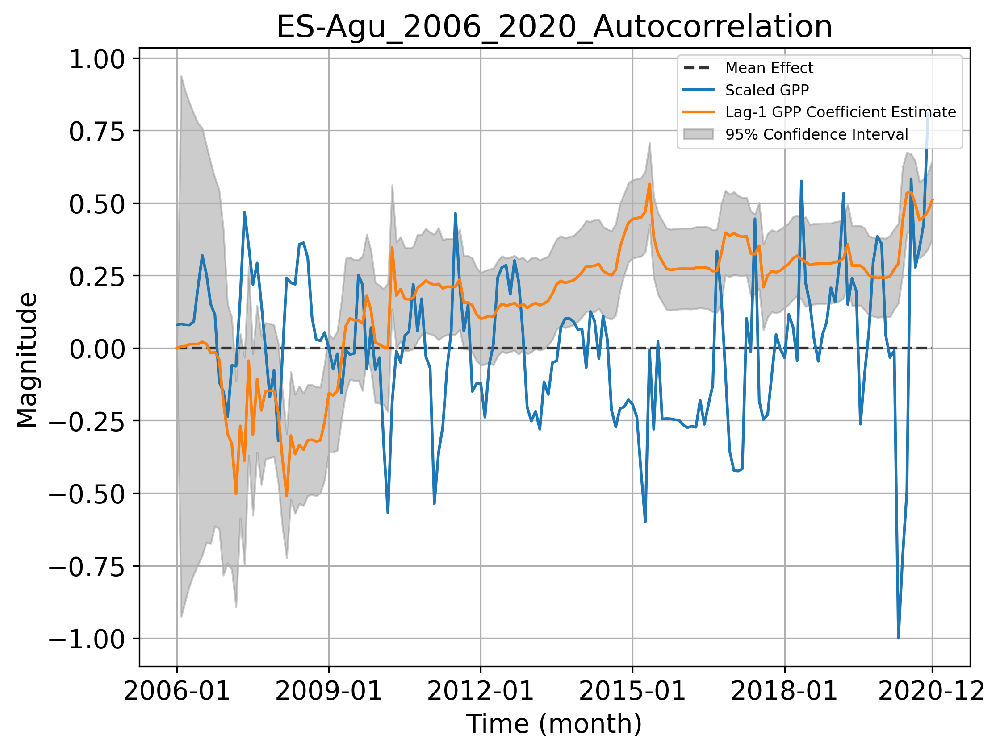

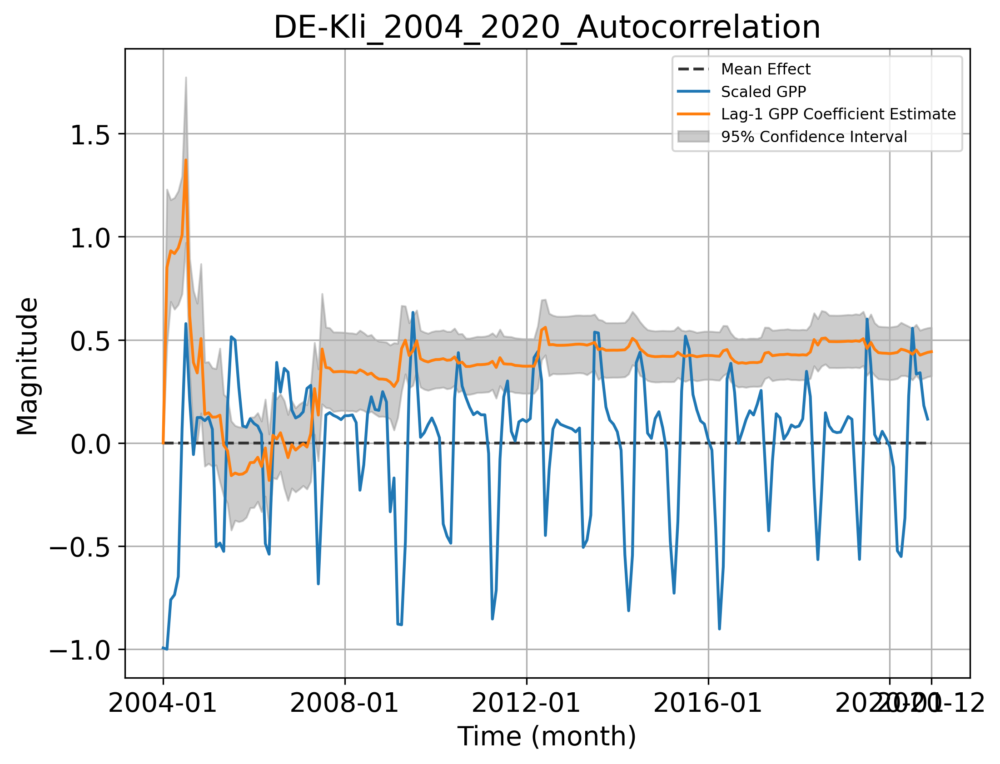

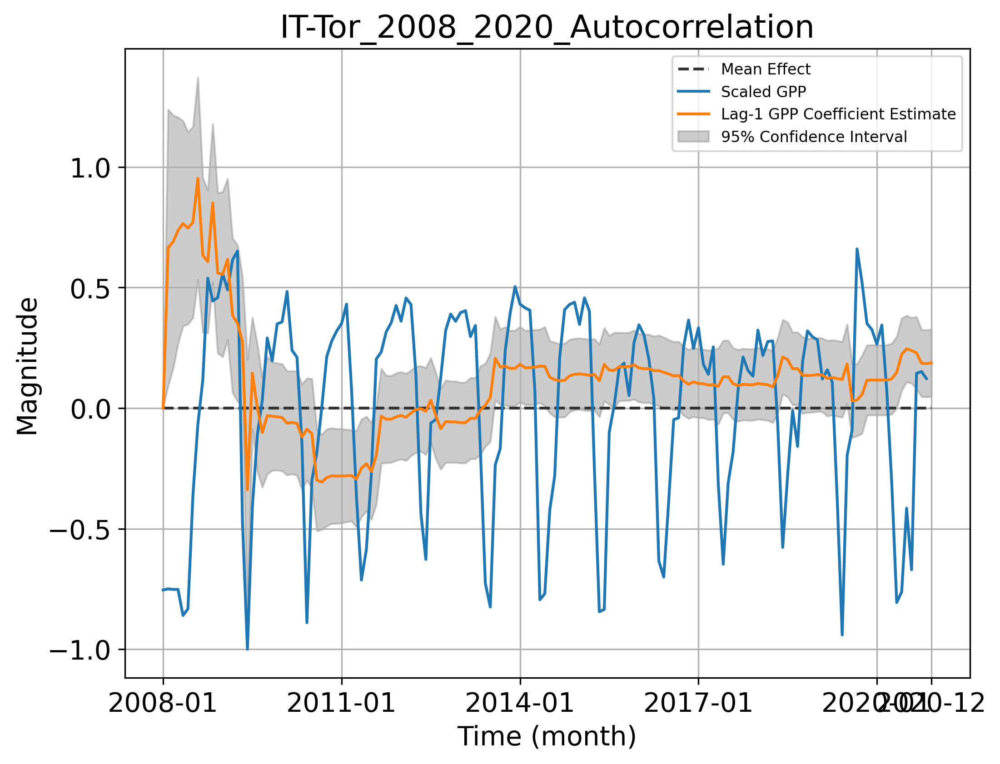

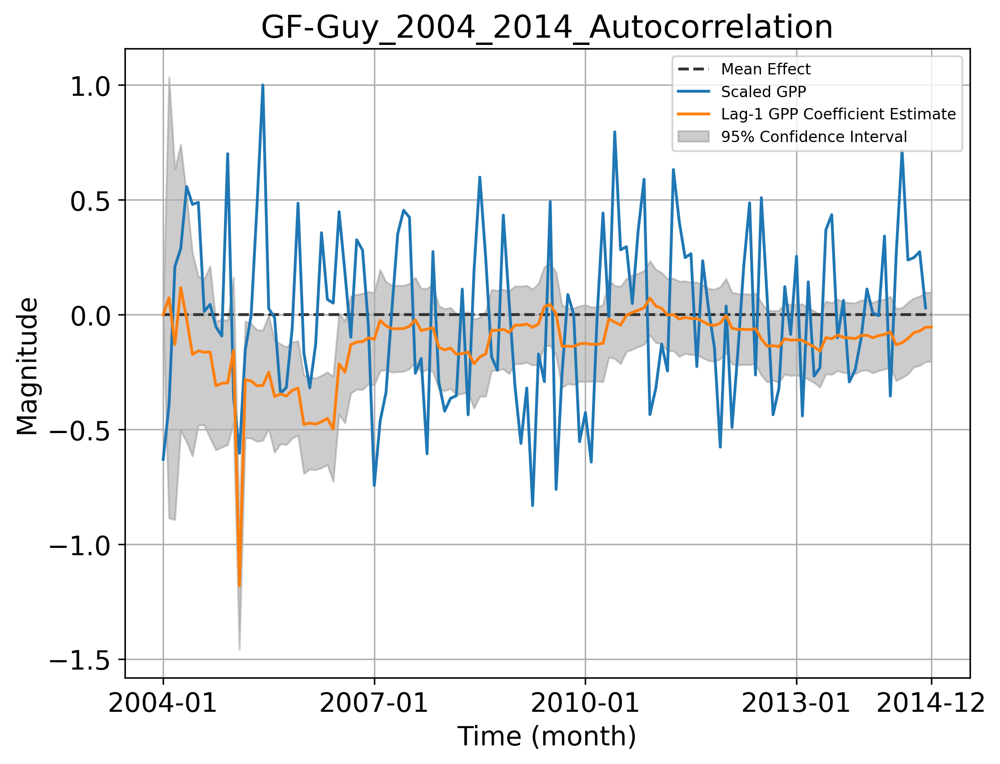

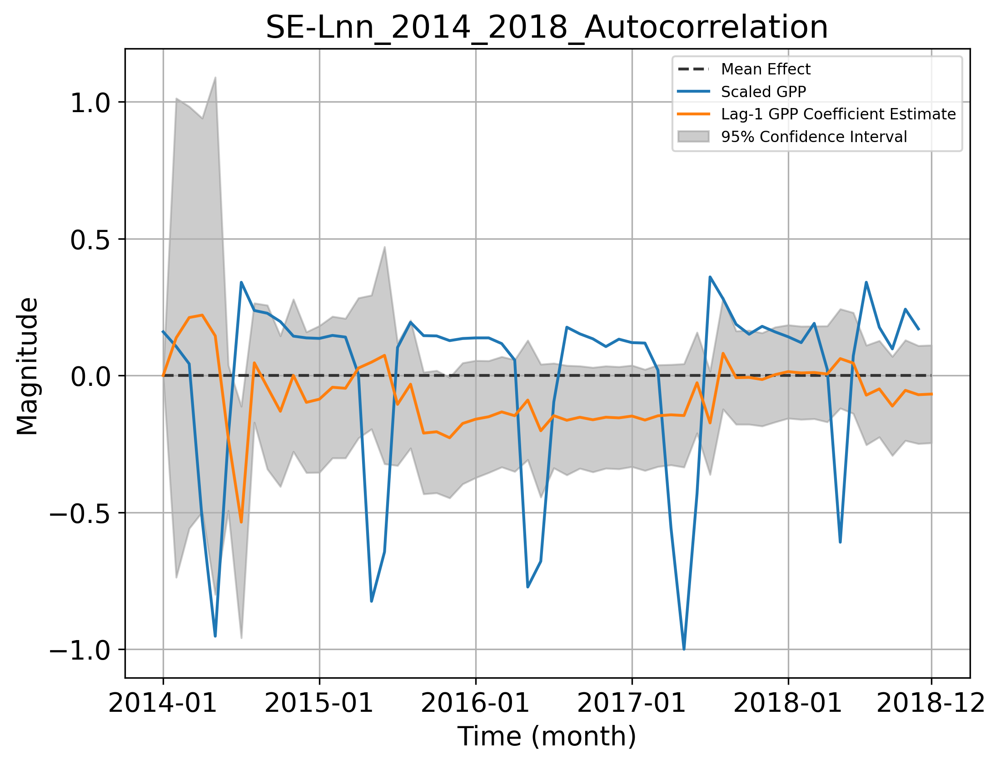

...

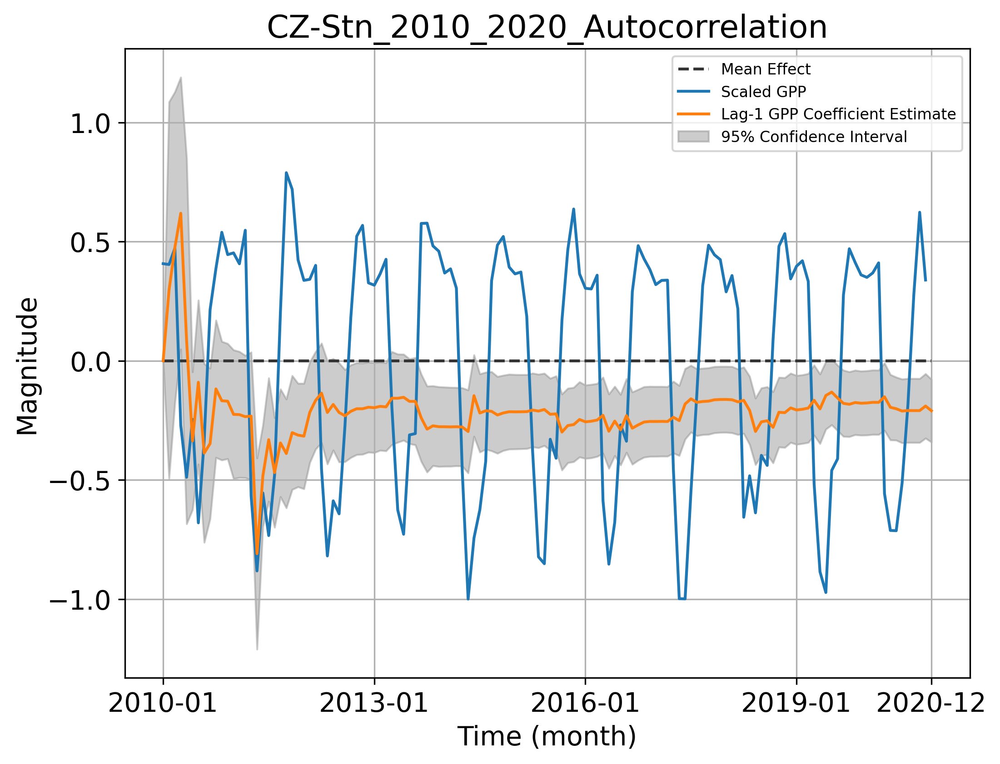

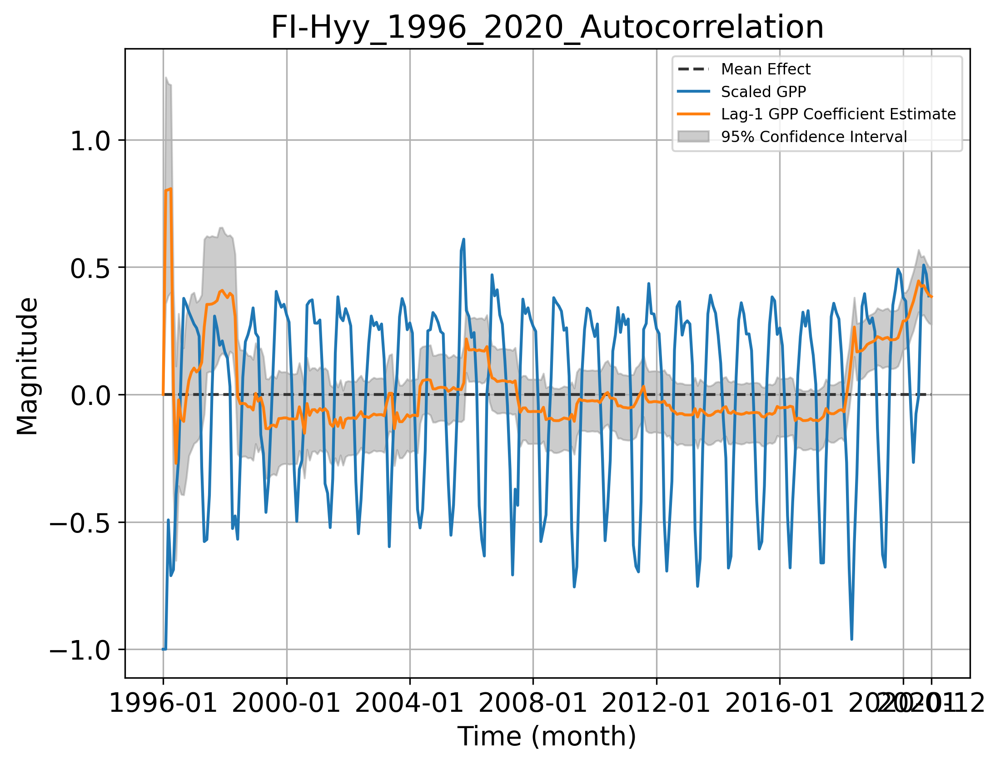

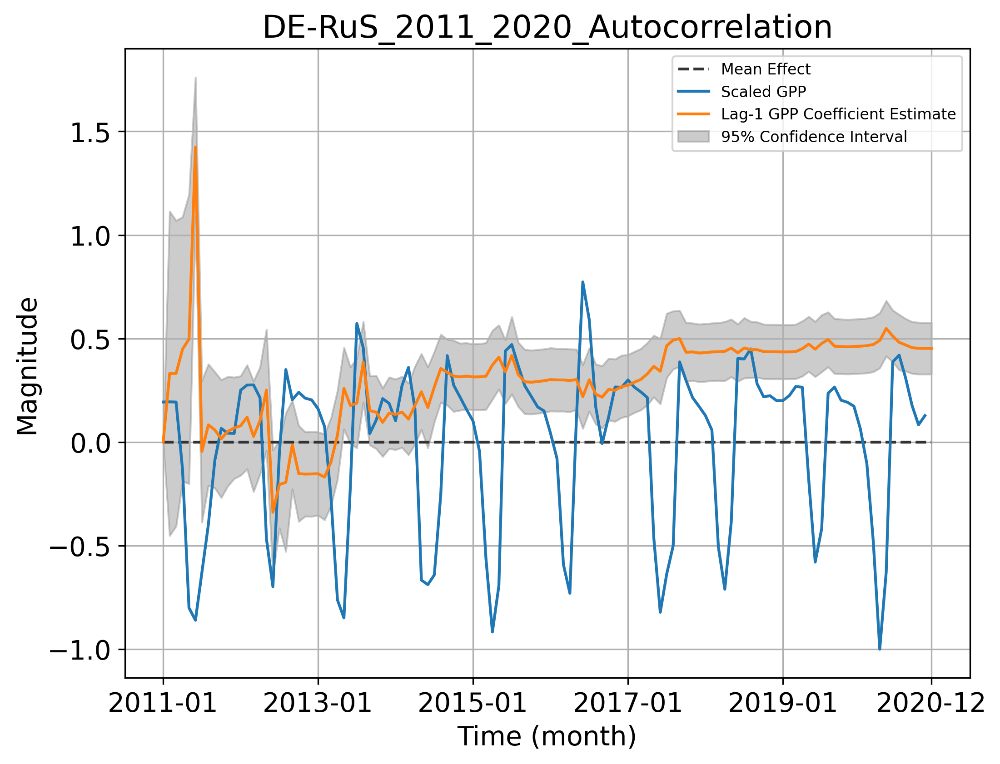

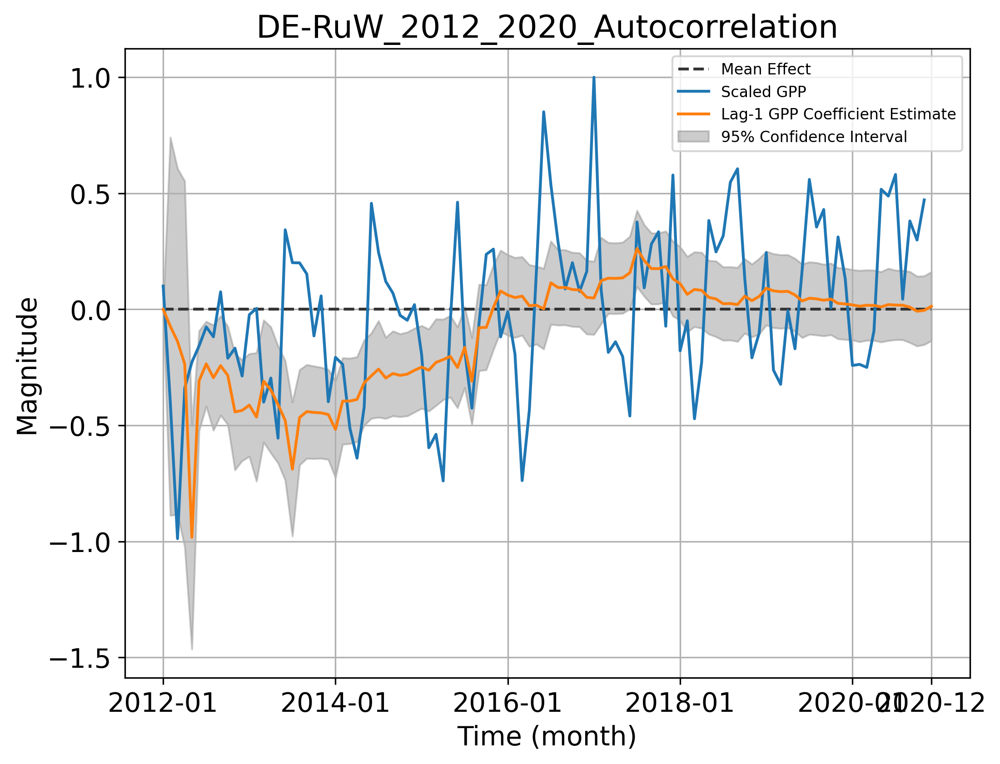

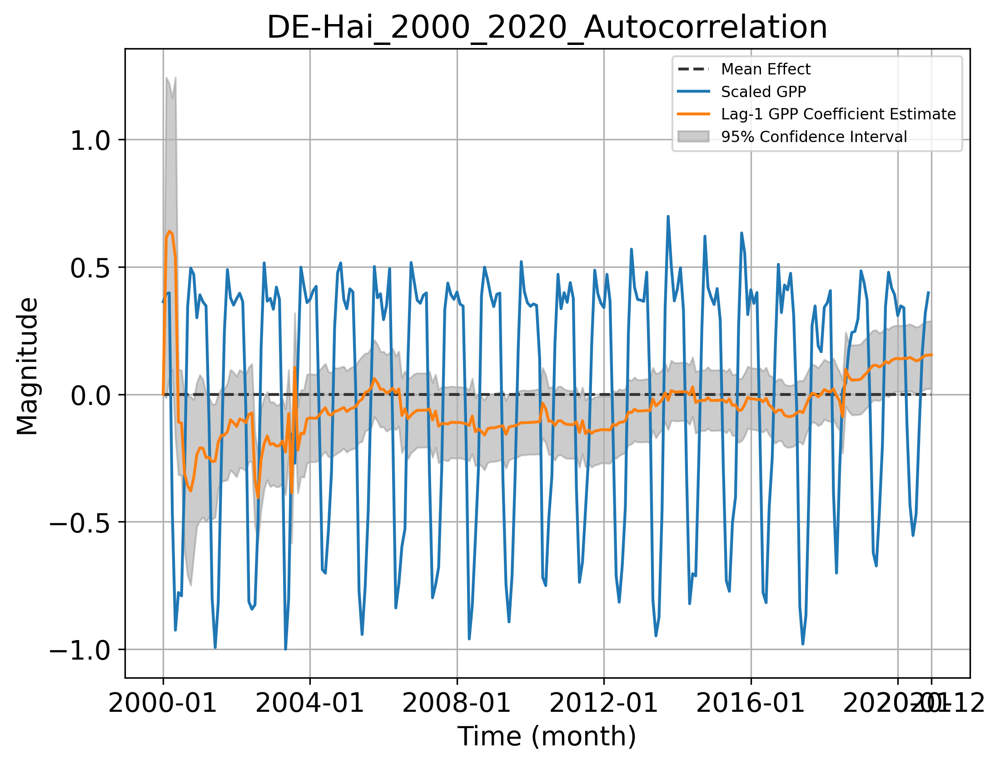

In [118]:
for file in files:
    
    file_path = Path + file
    print(file_path)
    # file_path = '/Users/quan/projects/gitprojects/fluxnet/Data/FLX_GF-Guy_FLUXNET2015_FULLSET_2004-2014_2-4/FLX_GF-Guy_FLUXNET2015_FULLSET_DD_2004-2014_2-4.csv'

    variable_list = ['TA_F', 'VPD_F', 'P_F'] #, 'NETRAD'
    GPP = pd.read_csv(file_path,sep = ',')[['TIMESTAMP','GPP_DT_VUT_REF', 'RECO_DT_VUT_REF','NEE_VUT_REF','NEE_VUT_REF_QC'] + variable_list]
    GPP[GPP == -9999] = np.nan
    GPP['datetime'] = pd.to_datetime(GPP['TIMESTAMP'], format='%Y%m%d')
    # GPP = GPP[GPP['datetime']<= '2015-01-01']
    GPP_monthly = GPP.drop('TIMESTAMP',axis=1).groupby([GPP['datetime'].dt.year, GPP['datetime'].dt.month]).mean()
    N = GPP_monthly['NEE_VUT_REF'].to_numpy();N

    CLM = GPP_monthly[variable_list].to_numpy();CLM

    # daily averages of climate conditions in the same order
    AvgCLM = GPP.groupby([GPP['datetime'].dt.month,GPP['datetime'].dt.day]).mean()[variable_list].to_numpy();AvgCLM
    date0 = GPP['datetime'][0] # the data of first NDVI obervation

    # GPP_DT_VUT_REF	TA_F	VPD_F	P_F	NETRAD	datetime
    # fluxnet2015 11.27800	25.648	3.872	9.8	105.013750	2004-01-01
    # icos: 11.26490	25.648	3.232	9.8	105.013750	2004-01-01

    # compute climate anomaly within each interval of two NDVI observations
    anCLM = computeAnormaly(CLM,AvgCLM,date0) # 计算气象因素的异常值,16天的数据与对应期间年平均数据的差值


    Y = N[1:]-np.nanmean(N) # 不理解为什么不是从N[0:]开始, 好像是要用当期的环境因素预测下一期的NDVI
    # use two seasonal harmonic components # 使用两个季节性谐波分量
    rseas = [1,2] 

    # include lag-1 centerred NDVI and precipitation in the regression module #只包含上起的NDVI和降水
    X = np.column_stack((N[:-1]-np.nanmean(N),anCLM[:-1,0]))

    # set up model and run forward filtering
    delta = 0.98

    M = Model(Y,X,rseas,delta) # 构建模型
    FF = forwardFilteringM(M,period=12) # 求解模型

    site_info = get_site_info(file)

    plt.figure(figsize=(8, 6), dpi=300)
    # scaled Y and the mean effects of autocorrelation
    # extract estimates on the coefficient corresponding to lag-1 NDVI
    plt.hlines(y=0, xmin=0, xmax=len(Y), color='#333333', linestyle='--', label='Mean Effect')
    plt.plot(Y/max(abs(Y)), label='Scaled GPP')
    plt.plot(FF.get('sm')[2,:], label='Lag-1 GPP Coefficient Estimate')

    sC = np.sqrt(FF.get('sC')[2,2,:]) # std
    plt.fill_between(range(len(sC)), FF.get('sm')[2,:] + sC, FF.get('sm')[2,:] - sC, color='gray', alpha=0.4, label='95% Confidence Interval')

    # 设置y轴刻度范围
    max_magnitude = max([abs(Y/max(abs(Y))).max(),abs(FF.get('sm')[2,:] + sC).max(),abs(FF.get('sm')[2,:] - sC).max()])

    # plt.ylim(-1*max_magnitude, 1*max_magnitude)

    # 添加标题
    plt.title("_".join(site_info) + '_Autocorrelation')
    plt.grid(False)

    # 添加网格线
    plt.grid(True)
    
    interver = 12
    
    if len(Y) > 60:
        interver = 24
    if len(Y) > 120:
        interver = 36
    if len(Y) > 180:
        interver = 48
            
    plt.xticks(list(range(0,len(Y),interver)) + [len(Y)], [(date0 + relativedelta(months= i)).strftime('%Y-%m') for i in list(range(0,len(Y),interver)) + [len(Y)]])
    plt.xticks(rotation=25)



    # 添加标签和图例
    plt.xlabel('Time (month)')
    plt.ylabel('Magnitude')
    plt.legend(fontsize = 8, loc='upper right')

    plt.savefig(Output_path+"_".join(site_info) + '_Autocorrelation.jpg')